<a href="https://colab.research.google.com/github/f73chen/UWARG-CV/blob/main/Tensorflow_Pylon_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Notebook overview
In this opportunity, I'm gonna walk you through the YOLOv5 training and implementation on custom data. It's based on a dataset available at https://github.com/sergiovirahonda/FaceMaskDataset which contains about 5000 images of people wearing/not wearing face mask. They are properly labeled in YOLO format.

For this particular project, I'll be using the https://github.com/zldrobit/yolov5.git repo instead of https://github.com/ultralytics/yolov5 - Both contain the necessary stuff to train and test YOLOv5 custom models, but the official repo doesn't contain some important improvements for model conversion yet. I hope they will be included to the Ultralytics branch shortly. For more info, take a look to the mentioned repo and updates. Said that, let's jump into the project :)

#Initial configurations

**IMPORTANT!** Remember to enable GPU usage. To do so, go to edit -> Notebook settings -> GPU. In addition, Runtime -> Change Runtime Type -> Hardware accelerator -> GPU)

In [1]:
import torch # Keep in mind that YOLOv5 runs un top of PyTorch, so we need to import it to the notebook
from IPython.display import Image #this to render predictions
#!git clone https://github.com/ultralytics/yolov5 # Use this if you want to keep the latest Ultralytics scripts.
!git clone https://github.com/zldrobit/yolov5.git # This is the repo that I mentioned above. It will allow the .pt -> .tflite conversion and usage.
%cd yolov5
!git checkout tf-android

Cloning into 'yolov5'...
remote: Enumerating objects: 4817, done.
remote: Total 4817 (delta 0), reused 0 (delta 0), pack-reused 4817
Receiving objects: 100% (4817/4817), 10.08 MiB | 25.29 MiB/s, done.
Resolving deltas: 100% (3117/3117), done.
/content/yolov5
Already on 'tf-android'
Your branch is up to date with 'origin/tf-android'.


In [2]:
#Let's navigate to yolov5 directory and install all dependencies indicated at requirements.txt file
#In addition, let's prompt if any GPU is available
!pip install -r requirements.txt
!pip install tensorflow==2.3.1 #Keep this version of TF as YOLOv5 works well with it.
print('All set. Using PyTorch version %s with %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 645kB 6.9MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 320.4MB 53kB/s 
     |████████████████████████████████| 460kB 45.9MB/s 
     |████████████████████████████████| 20.1MB 1.4MB/s 
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: tensorflow-estimator 2.4.0
    Uninstalling tensorflow-estimator-2.4.0:
      Successfully uninstalled tensorflow-estimator-2.4.0
  Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
  Found existing installation: tensorflow 2.4.1
    Uninstalling tensorflow-2.4.1:
      Successfully uninstalled tensorflow-2.4.1


All set. Using PyTorch version 1.8.1+cu101 with _CudaDeviceProperties(name='Tesla P4', major=6, minor=1, total_memory=7611MB, multi_processor_count=20)


# Dataset import
As I mentioned above, I'll be using a dataset gathered and labeled by myself.

In [6]:
%cd /content
%ls
!wget https://www.dropbox.com/s/mqzelrocii33q8s/Ariel_view_of_pylons_total.zip
!unzip Ariel_view_of_pylons_total

Streaming output truncated to the last 5000 lines.
  inflating: train/images/frame741_jpg.rf.78398cb27b077ae54d03b9a8adce3ebf.jpg  
  inflating: __MACOSX/train/images/._frame741_jpg.rf.78398cb27b077ae54d03b9a8adce3ebf.jpg  
  inflating: train/images/sec-2-6-image27_png.rf.1ea3820002a30c74f7b915a142d88548.jpg  
  inflating: __MACOSX/train/images/._sec-2-6-image27_png.rf.1ea3820002a30c74f7b915a142d88548.jpg  
  inflating: train/images/frame2865_jpg.rf.c9ff4ea43e1c355468b49e87105d1666.jpg  
  inflating: __MACOSX/train/images/._frame2865_jpg.rf.c9ff4ea43e1c355468b49e87105d1666.jpg  
  inflating: train/images/frame2785_jpg.rf.92744a12beb4e71bb59c94f3bb305a85.jpg  
  inflating: __MACOSX/train/images/._frame2785_jpg.rf.92744a12beb4e71bb59c94f3bb305a85.jpg  
  inflating: train/images/kang240_jpg.rf.6296d69f201d10cf3942fc90143a2964.jpg  
  inflating: __MACOSX/train/images/._kang240_jpg.rf.6296d69f201d10cf3942fc90143a2964.jpg  
  inflating: train/images/frame828_jpg.rf.24aa57ac84186aa9c4dd11ac13

**Manually drag dataset.yaml file from /content/FaceMaskDataset to /content/yolov5/data/ directory before running the below command.** To do so, expand the left side panel and navigate between directories.

Below we're gonna inspect the dataset.yaml file which is the dataset configuration file and contains the paths for training and validation images (the model will associate each image with its corresponding .txt file that contains the label coordinates), the quantity of classes and the classes' names

# Training
Once the initial configurations have been done, it's time to train the model on custom data. To do so, we first need to navigate to /yolov5 directory where the train.py file is located. These are the relevant considerations to implement such script:

- You must indicate the images sizes (415 in this case). The model  will stride each image to 416 pixels because 415 is not a 32 multiple (max stride) (13*32=416)
- Indicate the batch size - In this case we'll keep 16.
- You'll have to indicate the number of epochs. Keep in mind that the bigger the epochs number, the higher is going to be the confidence level of decisions the model will achieve. At some point overfitting is expected and if the dataset is relatively small, it will happen really fast.
- Through --data parameter you reference the .yaml file that contains the dataset configurations. 
- You'll need to specify the pretrained model your training pipeline will be using. Remember that the options available are YOLOv5s (yolov5s), YOLOv5m(yolov5m), YOLOv5l (yolov5l) and YOLOv5x (yolov5x) - in this particular case, the first options is excellent as per we require a very lightweight model.
- Finally --nosave is used to only save the final checkpoint and --cache enables the pipeline to cache images and therefore reduce training time. I want to keep the best metric so I won't use --nosave.

**IMPORTANT:**
To have an idea about how well the training is going, keep an eye on mAP@.5 metric (mean average precision). If it's close to 1, it means the model is achieving great results!

In [7]:
%ls

Ariel_view_of_pylons_total.zip  __MACOSX/     test/   valid/
data.yaml                       sample_data/  train/  yolov5/


In [9]:
# Train YOLOv5s on dataset for 30 epochs
%cd yolov5
!python train.py --img 416 --batch 16 --epochs 83 --data ../data.yaml --weights yolov5s.pt --cache

[Errno 2] No such file or directory: 'yolov5'
/content/yolov5
Using torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)


Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='', data='../data.yaml', device='', epochs=83, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='exp', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/exp2', single_cls=False, sync_bn=False, total_batch_size=16, weights='yolov5s.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2021-04-09 02:16:10.931982: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_e

During training it's likely the model reaches a top in metrics, it's ok. If it's not high enough, you'll have to evaluate if your dataset is too small or properly labeled.

Keep in mind that once training ends, all results are stored at runs/train/exp but this may vary.

# Detector performance evaluation with TensorBoard
TensorBoard is a fancy and very interactive way to explore the results achieved in the above's training pipeline. You could also implement some classic graphs to do so if you want - both options will take the results stored at /runs directory.

In [10]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

The mAP reached around 91% after epoch #20 and stays around that number, which is not a bad one. I kept # epochs very low because the top metric is reached before 30, so makes no sense to train for longer period of time. Let's see how confident the model makes inferences on images.

# Model testing

Let's see how well the model makes inferences on totally unseen data that I've scrapped from google and stored them in a new directory (you'll need to create it manually: /content/test_images).

I'll use the weights that deliver better performance. They are usually available at runs/train/exp/weights/best.pt, but just because I trained twice then they are stored at runs/train/exp2/weights/best.pt - keep that in mind.

In [11]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.4 --source ../test/images

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../test/images', tfl_int8=False, update=False, view_img=False, weights=['runs/train/exp2/weights/best.pt'])
Using torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)


Fusing layers... 
Model Summary: 224 layers, 7053910 parameters, 0 gradients, 16.3 GFLOPS
image 1/60 /content/test/images/frame201_jpg.rf.792c6dfde068331631acd7ac74ed01b3.jpg: 416x416 2 pylons, Done. (0.014s)
image 2/60 /content/test/images/frame2774_jpg.rf.33342d8ba3148ab7c808b1480a49409a.jpg: 416x416 2 pylons, Done. (0.014s)
image 3/60 /content/test/images/frame2782_jpg.rf.271856b0b1b749618739efb0ed4eb188.jpg: 416x416 3 pylons, Done. (0.014s)
image 4/60 /content/test/images/frame2787_jpg.rf.277ec0d8283a5e6c3ee5ea068a78ebe3.jpg: 416x416 4 pylons, Done. (0.015s)
image 5/60 /content/test/images/frame2802_jpg.rf.0d6068738

In the last output you may notice the labels added to each image. They are what I was expecting. Let's see how they look like.

In [12]:
#Detection results were saved at runs/detect/exp2, let's explore the output.
!ls runs/detect/exp2

ls: cannot access 'runs/detect/exp2': No such file or directory


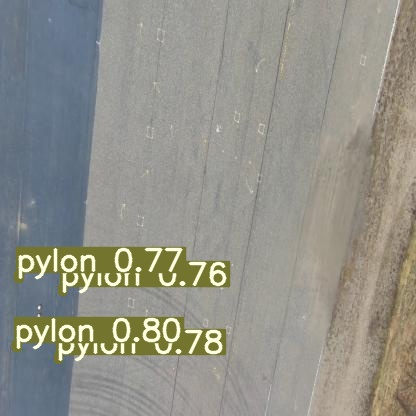

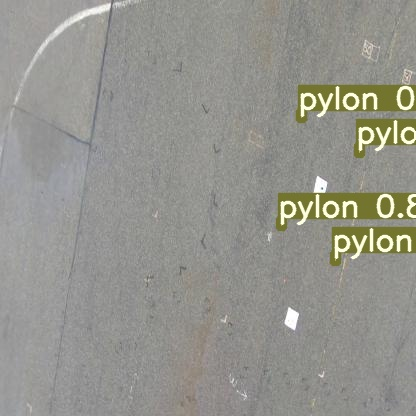

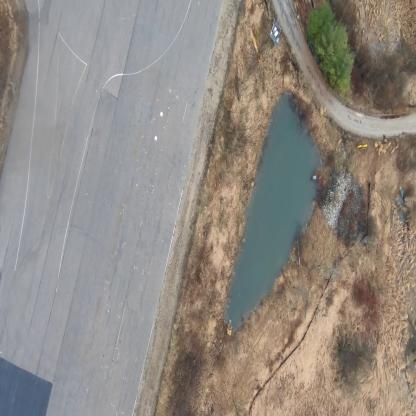

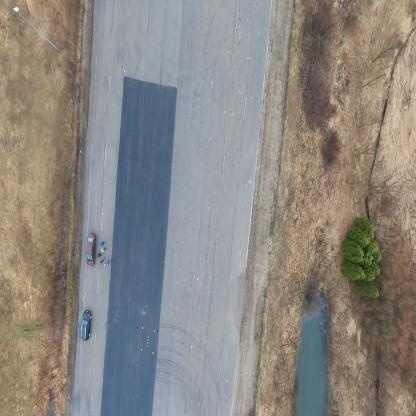

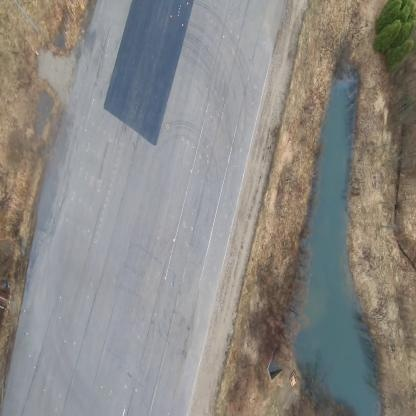

...

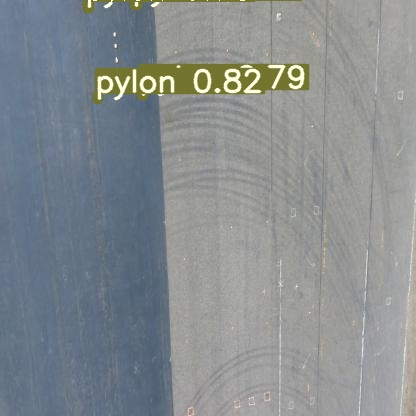

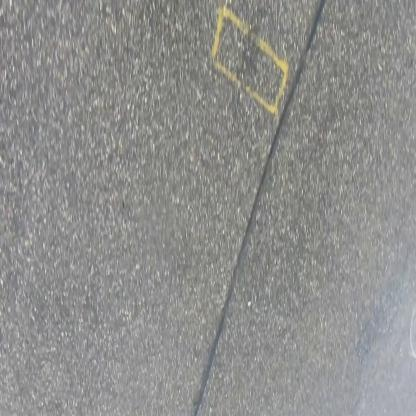

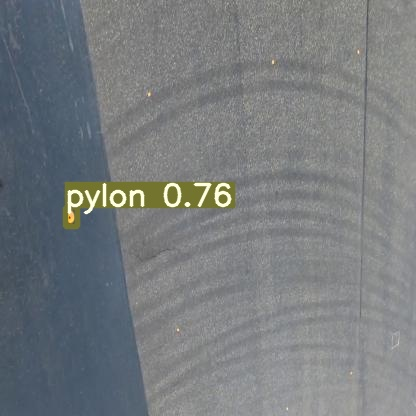

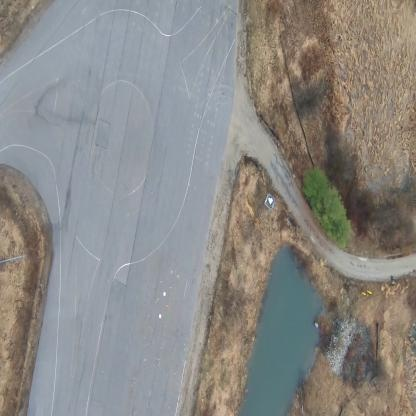

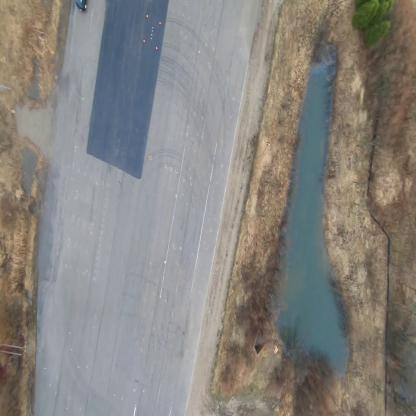

In [13]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

Alright, so far so good. They look properly labeled. Let's move on.

# Saving the weights for future use cases

We'll use the google.colab library to do so. Essentially we'll copy the best.pt file to our Google Drive where we can keep it for future uses. If you want to avoid the Google Drive step but still need to download it, then just browse to runs/train/exp/weights/best.pt (or runs/train/exp2/weights/best.pt in this case), right click on the .pt file and select download option.

Once you run the below's code, it will display a link where you'll have to click on to get an auth code. Copy and paste it into the field shown below.

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')
#%cp runs/train/exp2/weights/best.pt /content/gdrive/My\ Drive

# Transforming the PyTorch model to TensorFlow lite
To achieve this task, I'll implement the tf.py script to get the .tflite model weights in a very simple way. If I won't take this way, then would need to follow what Ultralytics suggests: to use their export.py file to get a .onnx file using the .pt one. This process will be very tedious in the sense that you will need then to transform it to TensorFlow weights with another script to finally obtain the .tflite format. It would take a long time and something could go wrong in the process.

As I said before, the model that I've obtained from https://github.com/zldrobit/yolov5.git repo contains some important improvements that will be adopted by Ultralytics soon and nowadays that process is widely used, so be confident to use it on your projects. If you want to use the Ultralytics suggested path, I'll indicate what you need to comment and uncomment though.

In [ ]:
# Uncomment all this if you want to follow the long path
#!pip install onnx>=1.7.0  # for ONNX export
#!pip install coremltools==4.0  # for CoreML export
#!python models/export.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --batch 1  # export at 640x640 with batch size 1

**Note for Ultralytics method:** We'll utilize the .onnx file. If you watch carefully above, you'll find a message like:

"Starting ONNX export with onnx 1.8.0...
ONNX export success, saved as /content/yolov5/runs/train/exp2/weights/best.onnx"

That's the file that we're interested on, let's convert the onnx file into TensorFlow format.

In [ ]:
# Uncomment this if you want to follow the long path
#!pip install tensorflow-addons
#!pip install onnx-tf
#!pip install tensorflow==2.3.0

In [ ]:
# Uncomment this if you want to follow the long path
#import tensorflow_addons as tfa
#import onnx
#from onnx_tf.backend import prepare
#import tensorflow as tf
#print(tf.__version__)

In [ ]:
# Uncomment this if you want to follow the long path
#base_model = onnx.load('/content/yolov5/runs/train/exp2/weights/best.onnx')
#to_tf = prepare(base_model)
#to_tf.export_graph("/content/yolov5/runs/train/exp2/weights/customyolov5")

Converting to tflite

In [ ]:
# Uncomment this if you want to follow the long path
#converter = tf.compat.v1.lite.TFLiteConverter.from_saved_model('/content/yolov5/runs/train/exp2/weights/customyolov5')
#tflite_model = converter.convert() #just FYI: this step could go wrong and your notebook instance could crash.

In [15]:
# Comment this if you want to follow the long path
!PYTHONPATH=. python3 /content/yolov5/models/tf.py --weight /content/yolov5/runs/train/exp2/weights/best.pt --cfg models/yolov5s.yaml --img 416 --source /content/train/images
#!PYTHONPATH=. python3 /content/yolov5/models/tf.py --weight /content/yolov5/runs/train/exp2/weights/best.pt --cfg models/yolov5s.yaml --img 416 --source /content/FaceMaskDataset/images/train --tfl-int8 --no-tfl-detect
# use the last line if you want the int8 model. It's a very lightweight file and weights.

2021-04-09 02:53:55.494497: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Namespace(batch_size=1, cfg='models/yolov5s.yaml', dynamic_batch_size=False, img_size=[416, 416], iou_thres=0.5, ncalib=100, no_tfl_detect=False, score_thres=0.4, source='/content/train/images', tf_nms=False, tfl_int8=False, topk_all=100, topk_per_class=100, weights='/content/yolov5/runs/train/exp2/weights/best.pt')

Starting TensorFlow saved_model export with TensorFlow 2.3.1...
Overriding models/yolov5s.yaml nc=80 with nc=1
2021-04-09 02:53:58.266498: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-04-09 02:53:58.273467: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-09 02:53:58.274125: I tensorflow/core/common_runtime/gp

# Script modification
There's one important thing to do before testing the .tflite file. The detect.py file contains the label names for COCO dataset. In order to get an accurate labeling during testing, you need to open up the file and look for "names = [...] in the line 157 and modify those names. In this case, that line should be names = ['Face mask','No face mask'].

# TFLite weights testing
Alright, if everything went OK with the above step, then you should be able to load and test what you've obtained. If you're using the FP16 weights, then use the line below. It will load the YOLOv5 model with the .tflite weights and will run inferencing on the images stored at /test_images. 

In [17]:
# Comment this if you want to follow the long path
!python detect.py --weight /content/yolov5/runs/train/exp2/weights/best.pb --img 416 --source ../test/images/ --classes 0

Namespace(agnostic_nms=False, augment=False, classes=[0], conf_thres=0.25, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../test/images/', tfl_int8=False, update=False, view_img=False, weights=['/content/yolov5/runs/train/exp2/weights/best.pb'])
Using torch 1.8.1+cu101 CUDA:0 (Tesla P4, 7611.9375MB)


2021-04-09 02:56:20.705417: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-04-09 02:56:21.898796: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-04-09 02:56:21.898981: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-09 02:56:21.899905: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 wit

Alright :) If you're still with me, then you're almost done! That's fantastic! As a last step, download the weights file stored at /content/yolov5/runs/train/exp2/weights/best-fp16.tflite and best.pt to use them in the real world implementation! 

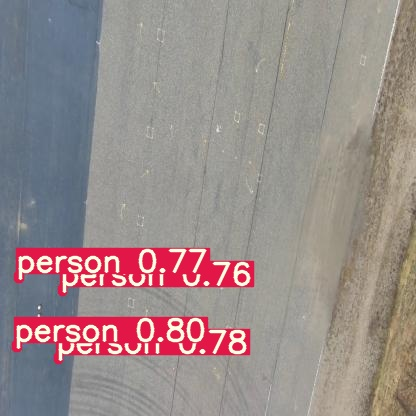

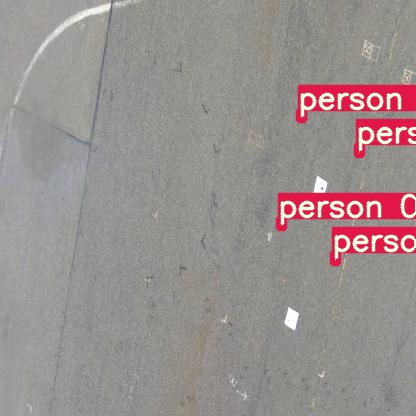

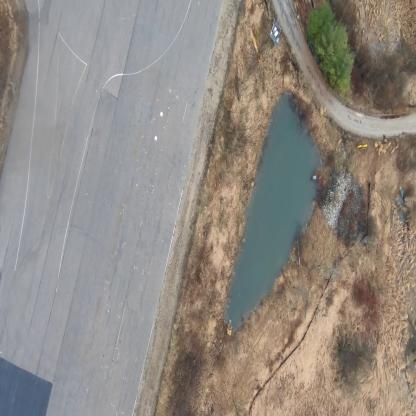

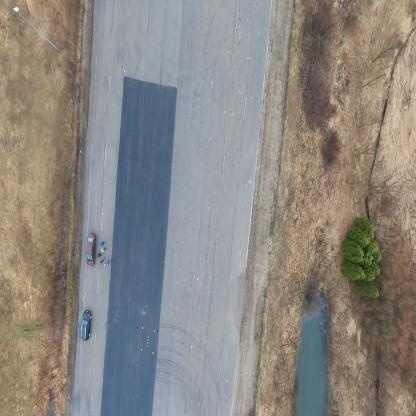

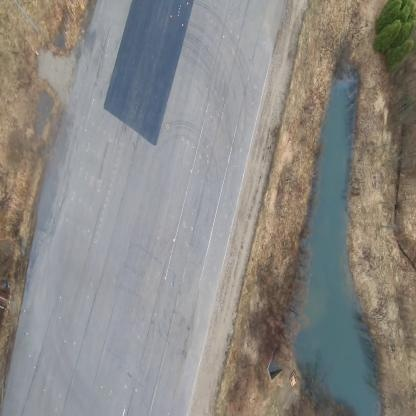

...

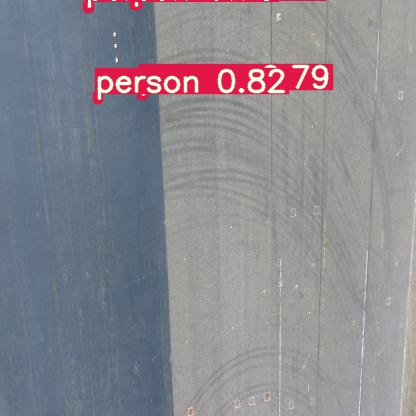

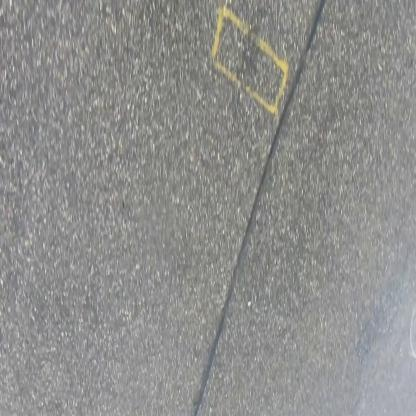

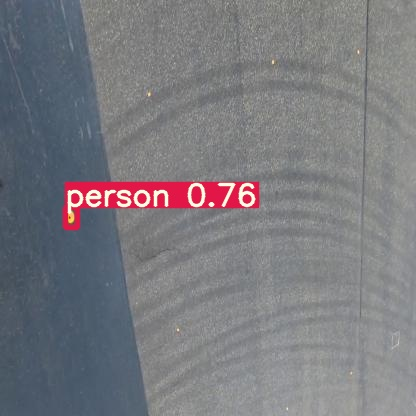

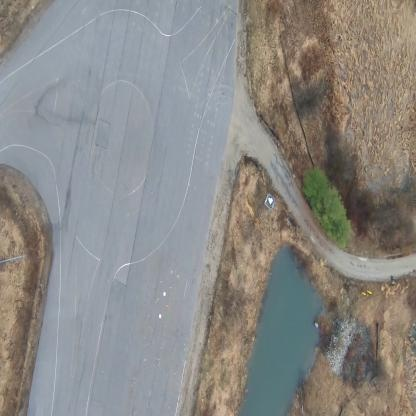

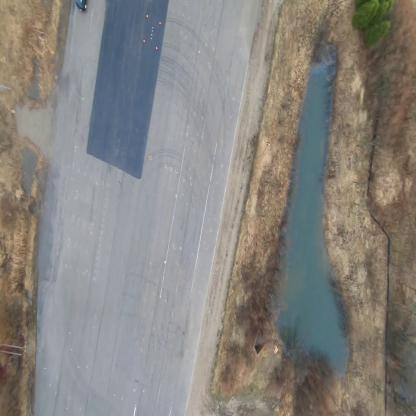

In [18]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")